# Capstone -1 Fraud Analysis Using ML Algorithms
SUBMITTED BY: GERALDINE MATHEW


###### Problem Statement: In this capstone project, you are going to analyze customer’s purchase data set and build a machine learning algorithm to detect fraud purchases. And also you are going to perform customer segmentation
Dataset: Purchase_Fraud_Data.csv

CAPSTONE PROJECT - 1
FRAUD ANALYSIS USING ML ALGORITHMS

Problem Statement: In this capstone project, you are going to analyze customer’s purchase data set and build a machine learning algorithm to detect fraud purchases. And also you are going to perform customer segmentation

Dataset: Purchase_Fraud_Data.csv

Dataset Description: Every row in this dataset contains information about purchases from multiple customers. Along with purchase details, we also have customer basic details like gender, date of birth etc. Individual column description as follows

User_id: Customer unique id
Signup_time: Date & Time at which the customer signup in the platform
Purchase_time: The latest purchase date & time from a customer
Purchase_value: Total purchase amount
Device_id: Unique device ID from which purchase was done
Source: Medium through which customers reached the platform
Browser: Browser used while purchasing
IP_address: IP Address from which purchase was done
Class: 1 = Target class; Fraud transaction; 0=Regular transaction
Category: Type of product purchased
Dob: Date of birth of the customer

Exploratory Data Analysis

1.	Summarize numerical, categorical and date columns separately and list down your inferences
2.	Identify and perform missing value treatment using appropriate techniques
3.	Univariate analysis: For each column perform appropriate univariate analysis. (i.e. perform distribution analysis on numerical columns and frequency analysis on categorical columns)
4.	Multivariate analysis: Take combinations of multiple columns and identify the relationship between them.
a.	Categorical vs numerical columns – bar charts, boxplots
b.	Numerical vs numerical columns – scatter plot
c.	Categorical vs multiple numerical columns – scatter plot
d.	Correlation matrix
e.	…
5.	Perform statistical hypothesis test to identify the relationship between input and target variables

Base Model for Benchmark

1.	Convert all the input columns to numerical columns using one hot encoding
2.	Make sure you temporarily ignore the date columns and id columns
3.	Split the data in training and testing
4.	Build a simple decision tree with max_depth=5 and identify accuracy and f1 score. Keep this as a bench mark values to explain the improvement post feature engineering 

Feature Engineering

Using the original data, perform the following feature engineering techniques to create new columns for modelling
1.	Using all the date columns, extract the following information wherever necessary
a.	Year, month, day, hour, day of the week (mon, tue, etc)
2.	Using date of birth column, try to calculate the appropriate age of the customer. (Compute difference between purchase date and date of birth)
3.	Using age column, identify age buckets using binning method
4.	Compute no. of hours/days between purchase time and signup time
5.	For all appropriate numerical variables, compute buckets using binning method

Model Building

1.	Convert all the input variables to numeric
2.	Split the new data in to training and testing
3.	Build the following classification models using new data
a.	Decision Trees
b.	Random Forest
c.	Boosting techniques
d.	XGBoost
4.	For all the above classifiers, make sure that you perform hyper parameter tuning to select optimal value hyper parameters
5.	For all the above methods, report accuracy and f1 score
6.	Also in a single plot, compare the ROC curves for all the above models
7.	Choose an appropriate model based on above inferences and report the same

Customer Segmentation

The company would like to segment their customers using various attributes, so that they can perform targeted marketing campaign. Do the following to group the customers in the different clusters

1.	 In the original feature engineered dataset, exclude the following columns: ids, dates, class (target column)
2.	Convert all the input variables to numeric
3.	Using Elbow method identify optimal number of clusters required to group customers in to various clusters
4.	Perform K-Means clustering using appropriate number of clusters
5.	Tag each customer with a cluster
6.	Cluster-wise report average values of all input variables



In [1]:
import numpy as np
import pandas as pd
from IPython.display import display, HTML
%matplotlib inline
import datetime
import seaborn as sns
from sklearn.model_selection import cross_val_score 
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score,precision_score

In [2]:
#reading the file

In [2]:
df = pd.read_csv('Purchase_Fraud_data.csv')
df.head(5)


,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,22-2-1976
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,2-1-1962
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,5-3-1962
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,3-7-1974
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,25-8-1970


In [3]:
df1=df.copy()

In [4]:
#Summarize numerical, categorical and date columns separately and list down your inferences

In [5]:
df.shape

(151112, 12)

In [6]:
df.count()

user_id           151112
signup_time       151112
purchase_time     151112
purchase_value    151112
device_id         151112
source            151112
browser           151112
sex               146185
ip_address        151112
class             151112
category          151112
dob               146188
dtype: int64

In [7]:
df.describe()

,user_id,purchase_value,ip_address,class
count,151112.000000,151112.000000,1.511120e+05,151112.000000
mean,200171.040970,50521.469003,2.152145e+09,0.093646
std,115369.285024,28533.667117,1.248497e+09,0.291336
min,2.000000,1016.000000,5.209350e+04,0.000000
25%,100642.500000,25919.000000,1.085934e+09,0.000000
50%,199958.000000,50484.000000,2.154770e+09,0.000000
75%,300054.000000,75296.250000,3.243258e+09,0.000000
max,400000.000000,100092.000000,4.294850e+09,1.000000


In [8]:
#Identify and perform missing value treatment using appropriate techniques

In [9]:
df.isna().sum()

user_id              0
signup_time          0
purchase_time        0
purchase_value       0
device_id            0
source               0
browser              0
sex               4927
ip_address           0
class                0
category             0
dob               4924
dtype: int64

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 151112 entries, 0 to 151111
Data columns (total 12 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   user_id         151112 non-null  int64  
 1   signup_time     151112 non-null  object 
 2   purchase_time   151112 non-null  object 
 3   purchase_value  151112 non-null  int64  
 4   device_id       151112 non-null  object 
 5   source          151112 non-null  object 
 6   browser         151112 non-null  object 
 7   sex             146185 non-null  object 
 8   ip_address      151112 non-null  float64
 9   class           151112 non-null  int64  
 10  category        151112 non-null  object 
 11  dob             146188 non-null  object 
dtypes: float64(1), int64(3), object(8)
memory usage: 13.8+ MB


In [11]:
df.isna().sum()/len(df)*100
#we can see the null values in Sex and Dob

user_id           0.000000
signup_time       0.000000
purchase_time     0.000000
purchase_value    0.000000
device_id         0.000000
source            0.000000
browser           0.000000
sex               3.260496
ip_address        0.000000
class             0.000000
category          0.000000
dob               3.258510
dtype: float64

In [12]:
#Since it has null values less than 10 % we can drop null values of sex and dob columns.

In [13]:
df['class'].value_counts()

0    136961
1     14151
Name: class, dtype: int64

In [14]:
df = df.dropna()
df.head()

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,22-2-1976
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,2-1-1962
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,5-3-1962
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,3-7-1974
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,25-8-1970


In [15]:
df.columns

Index(['user_id', 'signup_time', 'purchase_time', 'purchase_value',
       'device_id', 'source', 'browser', 'sex', 'ip_address', 'class',
       'category', 'dob'],
      dtype='object')

In [16]:
df['class'].value_counts()

0    128164
1     13240
Name: class, dtype: int64

In [17]:
df.isna().sum()/len(df)*100

user_id           0.0
signup_time       0.0
purchase_time     0.0
purchase_value    0.0
device_id         0.0
source            0.0
browser           0.0
sex               0.0
ip_address        0.0
class             0.0
category          0.0
dob               0.0
dtype: float64

In [18]:
df.skew()

C:\Users\asus\AppData\Local\Temp/ipykernel_18676/1665899112.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df.skew()


user_id           0.001247
purchase_value    0.000862
ip_address       -0.007756
class             2.789898
dtype: float64

In [19]:
df.std()

C:\Users\asus\AppData\Local\Temp/ipykernel_18676/3390915376.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df.std()


user_id           1.153234e+05
purchase_value    2.853566e+04
ip_address        1.248164e+09
class             2.913177e-01
dtype: float64

### Outlier visualization

<AxesSubplot:>

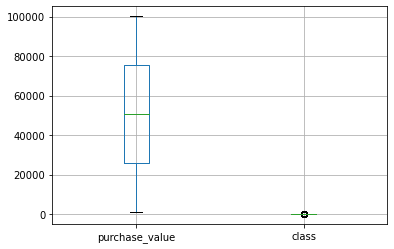

In [20]:
df.drop(['user_id','ip_address'],axis=1).boxplot()
# we can observe that no outlier present.

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 141404 entries, 0 to 151111
Data columns (total 12 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   user_id         141404 non-null  int64  
 1   signup_time     141404 non-null  object 
 2   purchase_time   141404 non-null  object 
 3   purchase_value  141404 non-null  int64  
 4   device_id       141404 non-null  object 
 5   source          141404 non-null  object 
 6   browser         141404 non-null  object 
 7   sex             141404 non-null  object 
 8   ip_address      141404 non-null  float64
 9   class           141404 non-null  int64  
 10  category        141404 non-null  object 
 11  dob             141404 non-null  object 
dtypes: float64(1), int64(3), object(8)
memory usage: 14.0+ MB


In [22]:
obj=df.select_dtypes(include='object').columns
obj

Index(['signup_time', 'purchase_time', 'device_id', 'source', 'browser', 'sex',
       'category', 'dob'],
      dtype='object')

In [23]:
df1['class']=df1['class'].astype('object')

### UNIVARIATE ANALYSIS OF NUMERICAL COLUMN

In [24]:
num=['purchase_value']

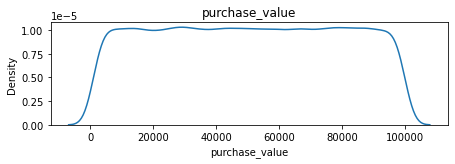

In [25]:
a = 4 
b = 2 
counter = 1 
plt.figure(figsize = [12, 8])

for i in num:
    plt.subplot(a,b,counter)
    plt.title(i)
    sns.kdeplot(df1.loc[:, i])
    counter = counter+1 
plt.tight_layout()
plt.show()

In [26]:
# Purchase value is highly skewed

###  UNIVARIATE ANALYSIS OF CATEGORICAL COLUMN

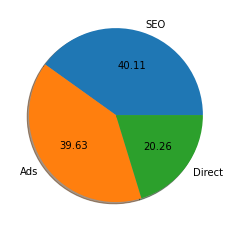

In [27]:
x=df1['source'].value_counts()
plt.pie(x,labels=x.index,autopct='%0.2f',shadow=True)
plt.show()

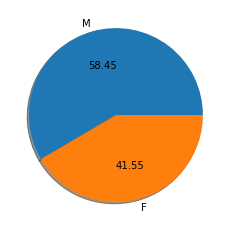

In [28]:
# SEO is highest in percentage followed by Ads and Direct.
x=df1['sex'].value_counts()
plt.pie(x,labels=x.index,autopct='%0.2f',shadow=True)
plt.show()


In [29]:
# In terms of gender the category of  Males are more in percentage as compared to females.

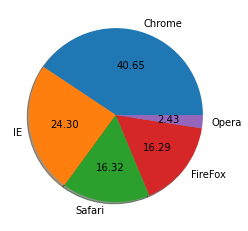

In [30]:
x=df1['browser'].value_counts()
plt.pie(x,labels=x.index,autopct='%0.2f',shadow=True)
plt.show()

In [31]:
#majority of the customers  are using Chrome followed by IE,Safari,Firefox and Opera.

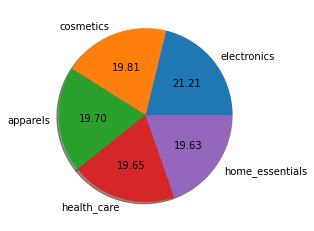

In [32]:
x=df1['category'].value_counts()
plt.pie(x,labels=x.index,autopct='%0.2f',shadow=True)
plt.show()

### Bi variate analysis of the categorical columns.Customer segmentation on the basis of source,browser,sex,category

In [33]:
obj=[ 'source', 'browser', 'sex','category']

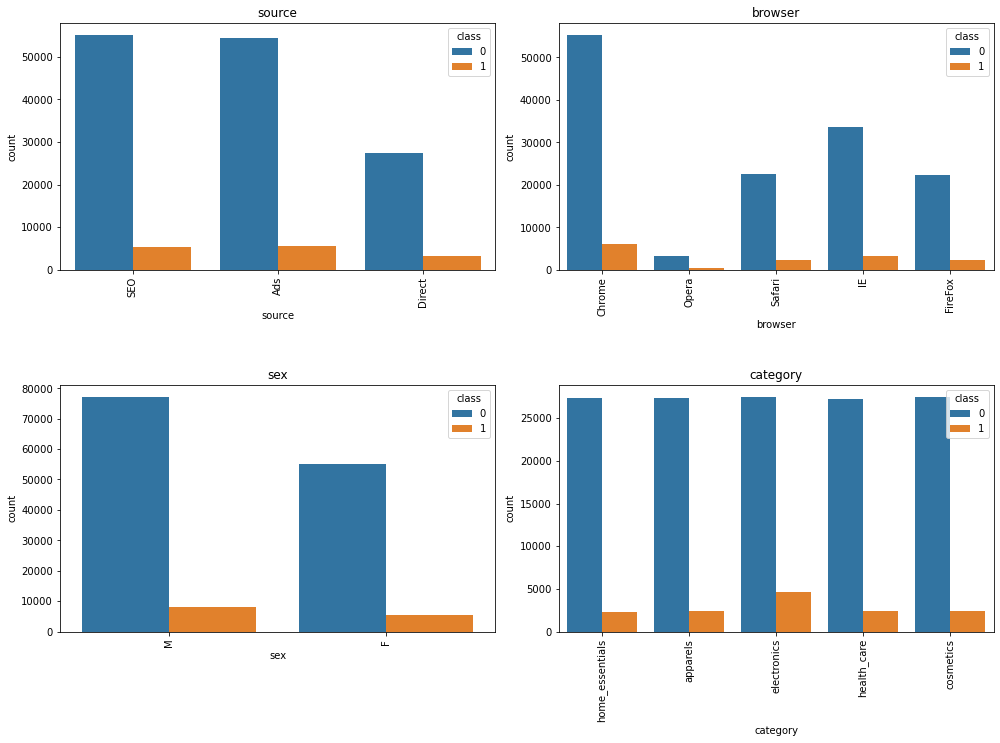

In [34]:
cols=obj
a = 3
b = 2
counter = 1
plt.figure(figsize = [14, 14])
for i in cols:
    plt.subplot(a,b,counter)
    plt.title(i)
    sns.countplot(x=df1[i],hue=df1['class'])
    counter = counter+1
    plt.xticks(rotation=90)    
plt.tight_layout()
plt.show()  

### Bi variate analysis of the continuous columns. Customer segmentation on the basis of purchase value

In [35]:
num=df1.select_dtypes(exclude='object').columns

In [36]:
num[1]

'purchase_value'

<AxesSubplot:title={'center':'category'}, xlabel='class', ylabel='purchase_value'>

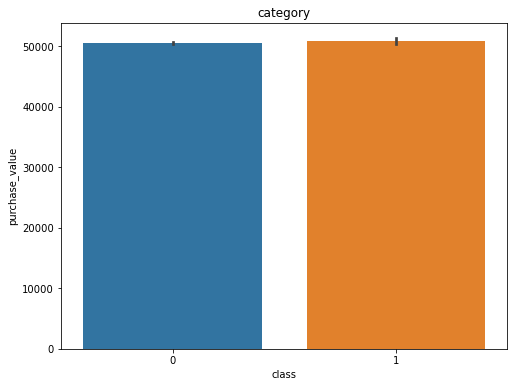

In [37]:
cols=num[1]
plt.figure(figsize=[8,6])
plt.title(i)
sns.barplot(y=df1['purchase_value'],x=df1['class'])

In [38]:
#from the above graph we can infer that approximately equal amount of Average purcahse is done by Fraud and non Fraud.

In [39]:
df1['purchase_value'].min()

1016

In [40]:
df1['purchase_value'].median()

50484.0

In [41]:
df1['purchase_value'].mean()

50521.46900312351

In [42]:
df1['purchase_value'].max()

100092

array([[<AxesSubplot:title={'center':'user_id'}>,
        <AxesSubplot:title={'center':'purchase_value'}>],
       [<AxesSubplot:title={'center':'ip_address'}>,
        <AxesSubplot:title={'center':'class'}>]], dtype=object)

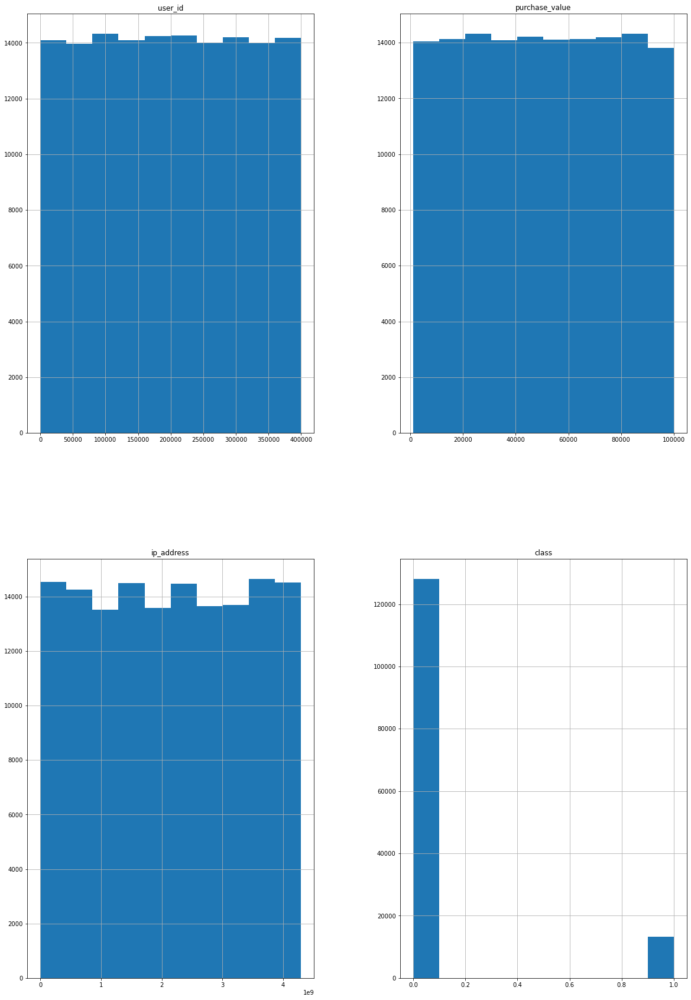

In [43]:
import matplotlib.pyplot as plt
%matplotlib inline

df.hist(figsize=(20,30))

<AxesSubplot:>

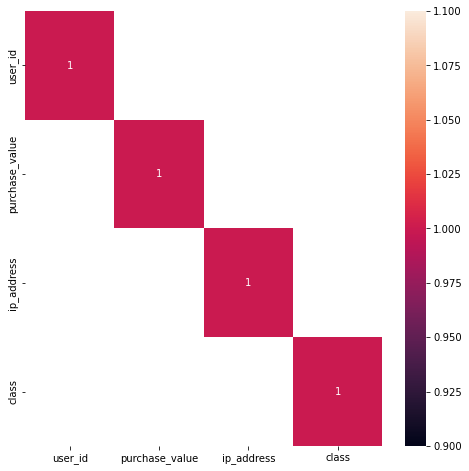

In [44]:
plt.figure(figsize=[8,8])
sns.heatmap(df.corr()[df.corr()>0.5],annot=True)

# No strong co-relation with the target class

### CREATING BASE MODEL FOR BENCH MARK

In [45]:
df['source'] = df['source'].replace({'SEO':0, 'Direct':1,'Ads':3})

In [46]:
df['browser'] = df['browser'].replace({'Chrome':0, 'Opera':1,'Safari':3,'IE':4,'FireFox':5})

In [47]:
df['sex'] = df['sex'].replace({'M':0, 'F':1})

In [48]:
df['category'] = df['category'].replace({'home_essentials':0, 'apparels':1,'electronics':3,'health_care':4,'cosmetics':5})

In [49]:
df1=df.drop(['user_id', 'signup_time','device_id', 'purchase_time', 
      'ip_address', 
       'dob'],axis=1)

In [50]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, auc, roc_curve
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt


In [51]:
df1

,purchase_value,source,browser,sex,class,category
0,65278,0,0,0,0,0
1,96399,3,0,1,0,1
2,57296,0,1,0,1,3
3,43650,0,3,0,0,4
4,45016,3,3,0,0,0
...,...,...,...,...,...,...
151107,58549,0,0,0,1,1
151108,57952,0,3,0,0,3
151109,19003,0,4,1,0,4
151110,68296,0,0,0,0,3


In [52]:
target_col = 'class'
input_cols =df1.drop(target_col, axis=1).columns
train_x, test_x, train_y, test_y = train_test_split(df1[input_cols],
                                                   df1[target_col],
                                                    test_size=0.2,
                                                    random_state=1)
train_x.shape, test_x.shape, train_y.shape, test_y.shape

((113123, 5), (28281, 5), (113123,), (28281,))

In [53]:
scaler = StandardScaler().fit(train_x)
train_x_scaled = pd.DataFrame(scaler.transform(train_x),
                              columns=train_x.columns,
                              index=train_x.index)
test_x_scaled = pd.DataFrame(scaler.transform(test_x),
                              columns=test_x.columns,
                              index=test_x.index)

In [54]:
def get_model_metrics(actual, predicted, classifier_name):
  acc = accuracy_score(actual, predicted)
  f1 = f1_score(actual, predicted)
  tn, fp, fn, tp = confusion_matrix(actual, predicted).ravel()
  sensitivity = tp / (tp + fn)
  specificity = tn / (tn + fp)
  fpr, tpr, thresholds = roc_curve(actual, predicted, pos_label=1)
  auc_value = auc(fpr, tpr)
  return {'accuracy': acc,
          'f1-score': f1,
          'classifier': classifier_name,
          'sensitivity': sensitivity,
          'specificity': specificity,
          'AUC': auc_value,
          'fpr_values': fpr,
          'tpr_values': tpr}

In [55]:
res_cols = ['classifier', 'f1-score', 'sensitivity', 'specificity', 'AUC', 'accuracy']
df_results = pd.DataFrame(columns=res_cols)

In [56]:
#USING SIMPLE DECISION TREE WITH MAX_DEPTH=5

In [57]:
# Decision Trees
classifier_name = 'Decision Tree'
model = DecisionTreeClassifier(max_depth=5, random_state=10).fit(train_x_scaled, train_y)
test_y_pred = model.predict(test_x_scaled)
dt_metrics = get_model_metrics(test_y, test_y_pred, classifier_name)
print(dt_metrics)
if classifier_name not in df_results['classifier'].values:
    df_results = df_results.append(dt_metrics, ignore_index=True)

{'accuracy': 0.9066157490894947, 'f1-score': 0.0, 'classifier': 'Decision Tree', 'sensitivity': 0.0, 'specificity': 0.999960999961, 'AUC': 0.4999804999805, 'fpr_values': array([0.0000000e+00, 3.9000039e-05, 1.0000000e+00]), 'tpr_values': array([0., 0., 1.])}


In [58]:
df_results.drop(['fpr_values', 'tpr_values'], axis=1)

,classifier,f1-score,sensitivity,specificity,AUC,accuracy
0,Decision Tree,0.0,0.0,0.999961,0.49998,0.906616


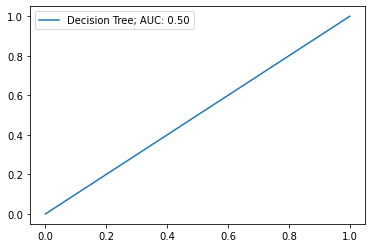

In [59]:
plt.plot(dt_metrics['fpr_values'], dt_metrics['tpr_values'])
plt.legend(['Decision Tree; AUC: %.2f' % dt_metrics['AUC']])

### PERFORM FEATURE ENGINEERING

Using the original data, perform the following feature engineering techniques to create new columns for modelling

Using all the date columns, extract the following information wherever necessary a. Year, month, day, hour, day of the week (mon, tue, etc)
Using date of birth column, try to calculate the appropriate age of the customer. (Compute difference between purchase date and date of birth)
Using age column, identify age buckets using binning method
Compute no. of hours/days between purchase time and signup time
For all appropriate numerical variables, compute buckets using binning method

In [60]:
df2 = pd.read_csv('Purchase_Fraud_data.csv')
df2.head(5)

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,22-2-1976
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,2-1-1962
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,5-3-1962
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,3-7-1974
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,25-8-1970


In [61]:
df2.isna().sum()

user_id              0
signup_time          0
purchase_time        0
purchase_value       0
device_id            0
source               0
browser              0
sex               4927
ip_address           0
class                0
category             0
dob               4924
dtype: int64

In [62]:
df2.isna().sum()/len(df2)*100
#we can see the null values in Sex and Dob

user_id           0.000000
signup_time       0.000000
purchase_time     0.000000
purchase_value    0.000000
device_id         0.000000
source            0.000000
browser           0.000000
sex               3.260496
ip_address        0.000000
class             0.000000
category          0.000000
dob               3.258510
dtype: float64

In [63]:
df2= df2.dropna()
df2.head()

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,22-2-1976
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,2-1-1962
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,5-3-1962
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,3-7-1974
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,25-8-1970


In [64]:
#Binning of Purchase Column

In [65]:
df2['Purchase_Amount_Cat']=pd.cut(df2['purchase_value'],bins=[1016 ,20000,50000,100092],
                                labels=['purchase_value in 1k and  20k','purchase_value in 20k and 50k','purchase_value Between  50k and 100k'])

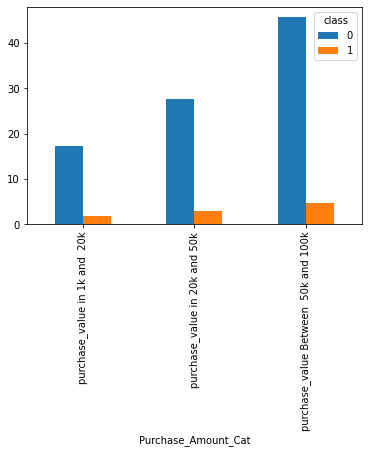

In [66]:
(pd.crosstab(df2['Purchase_Amount_Cat'],df2['class'],normalize=True)*100).plot(kind="bar")
plt.show()

In [67]:
# from the above graph we  can infer that Most of the regular transactions are taking place between purchase amount of 20k to 100k.
# Most Fraud Transaction are happening in range 50 k and 100 k

In [68]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 141404 entries, 0 to 151111
Data columns (total 13 columns):
 #   Column               Non-Null Count   Dtype   
---  ------               --------------   -----   
 0   user_id              141404 non-null  int64   
 1   signup_time          141404 non-null  object  
 2   purchase_time        141404 non-null  object  
 3   purchase_value       141404 non-null  int64   
 4   device_id            141404 non-null  object  
 5   source               141404 non-null  object  
 6   browser              141404 non-null  object  
 7   sex                  141404 non-null  object  
 8   ip_address           141404 non-null  float64 
 9   class                141404 non-null  int64   
 10  category             141404 non-null  object  
 11  dob                  141404 non-null  object  
 12  Purchase_Amount_Cat  141403 non-null  category
dtypes: category(1), float64(1), int64(3), object(8)
memory usage: 14.2+ MB


In [69]:
df2.head()

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob,Purchase_Amount_Cat
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,22-2-1976,purchase_value Between 50k and 100k
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,2-1-1962,purchase_value Between 50k and 100k
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,5-3-1962,purchase_value Between 50k and 100k
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,3-7-1974,purchase_value in 20k and 50k
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,25-8-1970,purchase_value in 20k and 50k


In [70]:
df2['class'].value_counts()

0    128164
1     13240
Name: class, dtype: int64

In [71]:
#We can see that our target class is imbalanced 

### Conversion Of Date Time of Signup and Purchase Time

In [72]:
import datetime as dt
df2['tot_mins_diff']=pd.to_datetime(df2['purchase_time'])-pd.to_datetime(df2['signup_time'])

df2.head()

df2['tot_mins_diff'] = df2['tot_mins_diff'].dt.total_seconds()

# Conversion of Difference in Minutes 

df2['tot_mins_diff']=df2['tot_mins_diff']/60

df2.head()

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob,Purchase_Amount_Cat,tot_mins_diff
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,22-2-1976,purchase_value Between 50k and 100k,75111.366667
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,2-1-1962,purchase_value Between 50k and 100k,299.066667
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,5-3-1962,purchase_value Between 50k and 100k,0.016667
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,3-7-1974,purchase_value in 20k and 50k,8201.416667
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,25-8-1970,purchase_value in 20k and 50k,72691.016667


In [73]:
df2

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob,Purchase_Amount_Cat,tot_mins_diff
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,22-2-1976,purchase_value Between 50k and 100k,75111.366667
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,2-1-1962,purchase_value Between 50k and 100k,299.066667
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,5-3-1962,purchase_value Between 50k and 100k,0.016667
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,3-7-1974,purchase_value in 20k and 50k,8201.416667
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,25-8-1970,purchase_value in 20k and 50k,72691.016667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151107,345170,2015-01-27 03:03:34,2015-03-29 00:30:47,58549,XPSKTWGPWINLR,SEO,Chrome,M,3.451155e+09,1,apparels,7-8-1987,purchase_value Between 50k and 100k,87687.216667
151108,274471,2015-05-15 17:43:29,2015-05-26 12:24:39,57952,LYSFABUCPCGBA,SEO,Safari,M,2.439047e+09,0,electronics,9-10-1983,purchase_value Between 50k and 100k,15521.166667
151109,368416,2015-03-03 23:07:31,2015-05-20 07:07:47,19003,MEQHCSJUBRBFE,SEO,IE,F,2.748471e+09,0,health_care,17-9-1989,purchase_value in 1k and 20k,111360.266667
151110,207709,2015-07-09 20:06:07,2015-09-07 09:34:46,68296,CMCXFGRHYSTVJ,SEO,Chrome,M,3.601175e+09,0,electronics,1-2-1978,purchase_value Between 50k and 100k,85768.650000


In [74]:
#df2.drop(['signup_time','purchase_time'],axis=1,inplace=True)

### Customer segmentation on the basis of difference between signup time and purchase time

In [75]:
df2['tot_mins_diff'].max()

172799.53333333333

In [76]:
df2['tot_mins_diff'].min()

0.016666666666666666

In [77]:
df2['tot_mins_diff'].mean()

81064.4638903388

In [78]:
df2['tot_mins_diff'].median()

80805.4

In [79]:
df2['total_mins_diff']=pd.cut(df2['tot_mins_diff'],bins=[0.01 ,1000,50000,173000],
                                labels=['time between 0 to 1000 min','time between 1000 to 50000 min','time between 50000 to 1730000 min'])

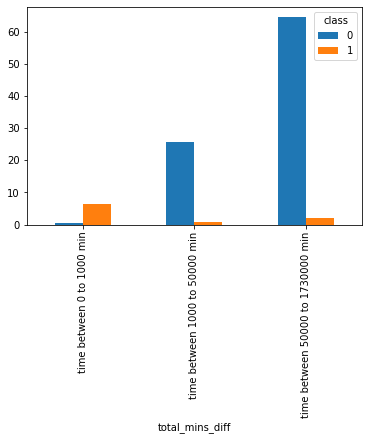

In [80]:
(pd.crosstab(df2['total_mins_diff'],df2['class'],normalize=True)*100).plot(kind="bar")
plt.show()

In [81]:
# Most of the fraud transactions are betwwen to 0 to 1000 mins of interval.
# We can also observe that fraud people are taking less time than people who are making regular transaction.
# people who are making Regular transactions are taking more time than 1000 mins.

### Customer segmentation on the basis of different age group

In [82]:
import datetime as dt
df2['dob'] = pd.to_datetime(df2['dob'], format = "%d-%m-%Y")
now = pd.Timestamp('now')
df2['age'] = (now - df2['dob'])
df2['age']  = df2['age'].astype(str)
df2[['age','age_waste']] = df2['age'].str.split("days",expand=True)

In [83]:
df2 = df2.drop(['age_waste'],axis = 1)
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 141404 entries, 0 to 151111
Data columns (total 16 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   user_id              141404 non-null  int64         
 1   signup_time          141404 non-null  object        
 2   purchase_time        141404 non-null  object        
 3   purchase_value       141404 non-null  int64         
 4   device_id            141404 non-null  object        
 5   source               141404 non-null  object        
 6   browser              141404 non-null  object        
 7   sex                  141404 non-null  object        
 8   ip_address           141404 non-null  float64       
 9   class                141404 non-null  int64         
 10  category             141404 non-null  object        
 11  dob                  141404 non-null  datetime64[ns]
 12  Purchase_Amount_Cat  141403 non-null  category      
 13  tot_mins_diff 

In [84]:
df2['age'] = pd.to_numeric(df2['age'], errors='coerce')

In [85]:
df2['age']=df2['age']/365

In [86]:
df2['age'].max()

84.1041095890411

In [87]:
df2['age'].min()

25.44931506849315

In [88]:
df2['age'].mean()

41.78624545313232

In [89]:
df2['age'].median()

40.81643835616438

In [90]:
df2['age']=pd.cut(df2['age'],bins=[20,35,50,83],
                                labels=['age between 20 to 35','age between 35 to 50','age between 50 to 83'])

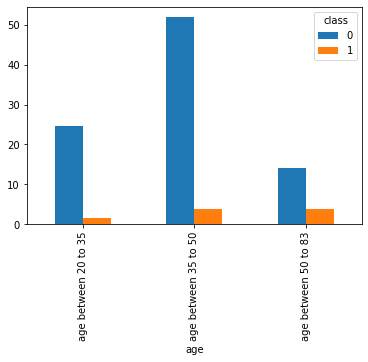

In [91]:
(pd.crosstab(df2['age'],df2['class'],normalize=True)*100).plot(kind="bar")
plt.show()

# Fraud transactions are higher between the ages of 50 to 83.
# Most of the regular transactions are done by the age group of 35 to 50.

In [92]:
df2.drop(['signup_time','purchase_time',  'dob','device_id','ip_address','user_id','total_mins_diff','Purchase_Amount_Cat','age'],axis=1,inplace=True)

In [93]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 141404 entries, 0 to 151111
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   purchase_value  141404 non-null  int64  
 1   source          141404 non-null  object 
 2   browser         141404 non-null  object 
 3   sex             141404 non-null  object 
 4   class           141404 non-null  int64  
 5   category        141404 non-null  object 
 6   tot_mins_diff   141404 non-null  float64
dtypes: float64(1), int64(2), object(4)
memory usage: 8.6+ MB


In [94]:
# Here We are converting categorical data into dummy or indicator variables.
df2=pd.get_dummies(df2,drop_first=True)

<AxesSubplot:>

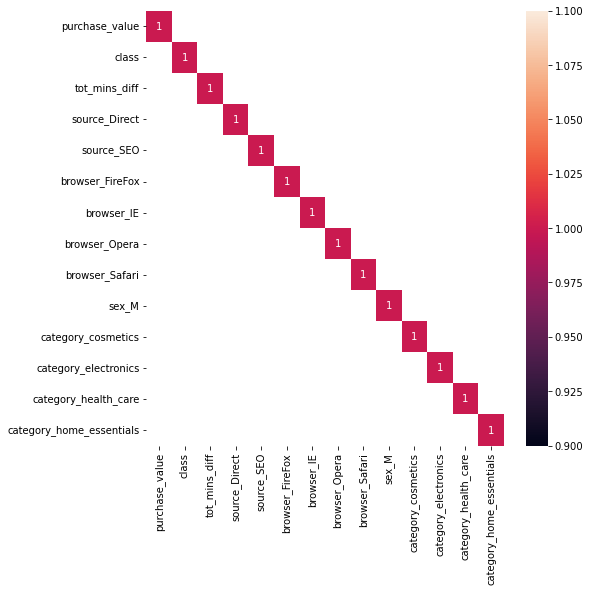

In [95]:
plt.figure(figsize=[8,8])
sns.heatmap(df2.corr()[df2.corr()>0.5],annot=True)

In [96]:
# No strong co-relation with the target class

#Perform statistical hypothesis test to identify the relationship between input and target variables

# Plotting Histogram for every columns


array([[<AxesSubplot:title={'center':'purchase_value'}>,
        <AxesSubplot:title={'center':'class'}>,
        <AxesSubplot:title={'center':'tot_mins_diff'}>,
        <AxesSubplot:title={'center':'source_Direct'}>],
       [<AxesSubplot:title={'center':'source_SEO'}>,
        <AxesSubplot:title={'center':'browser_FireFox'}>,
        <AxesSubplot:title={'center':'browser_IE'}>,
        <AxesSubplot:title={'center':'browser_Opera'}>],
       [<AxesSubplot:title={'center':'browser_Safari'}>,
        <AxesSubplot:title={'center':'sex_M'}>,
        <AxesSubplot:title={'center':'category_cosmetics'}>,
        <AxesSubplot:title={'center':'category_electronics'}>],
       [<AxesSubplot:title={'center':'category_health_care'}>,
        <AxesSubplot:title={'center':'category_home_essentials'}>,
        <AxesSubplot:>, <AxesSubplot:>]], dtype=object)

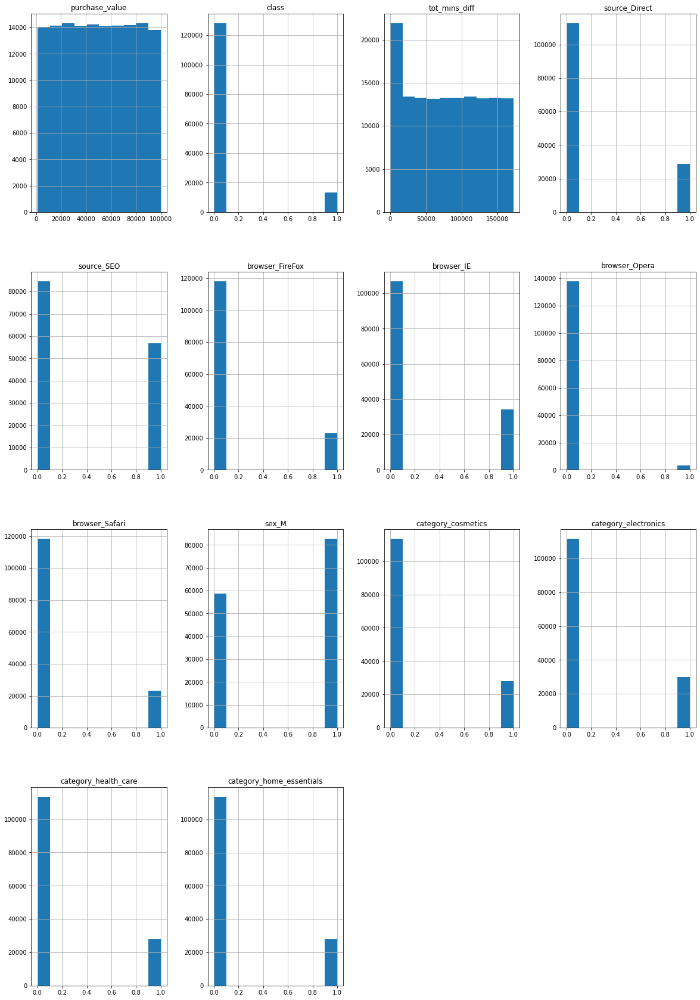

In [97]:
import matplotlib.pyplot as plt
%matplotlib inline

df2.hist(figsize=(20,30))

### MODEL AFTER PERFORMING FEATURE ENGINEERING

Model Building

Convert all the input variables to numeric
Split the new data in to training and testing
Build the following classification models using new data a. Decision Trees b. Random Forest c. Boosting techniques d. XGBoost
For all the above classifiers, make sure that you perform hyper parameter tuning to select optimal value hyper parameters
For all the above methods, report accuracy and f1 score
Also in a single plot, compare the ROC curves for all the above models
Choose an appropriate model based on above inferences and report the same

In [98]:
from sklearn.model_selection import train_test_split


In [99]:
X=df2.drop('class',axis=1)
y=df2['class']

In [100]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=10)

In [108]:
gs.best_estimator_

DecisionTreeRegressor(max_depth=5)

In [ ]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=10)

In [102]:
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.linear_model import LogisticRegression

In [103]:
df2['class'].value_counts()

0    128164
1     13240
Name: class, dtype: int64

In [104]:
#Using Decision tree model

In [105]:
pip install imblearn

Note: you may need to restart the kernel to use updated packages.


In [106]:
from imblearn.over_sampling import SMOTE
sm = SMOTE()
X_train_sm, y_train_sm= sm.fit_resample(X_train, y_train.astype('int'))

In [107]:
df2['class'].value_counts()

0    128164
1     13240
Name: class, dtype: int64

In [108]:
y_train_sm.value_counts()

0    102528
1    102528
Name: class, dtype: int64

In [109]:
lr=LogisticRegression(random_state=20,solver='liblinear')
lr_model=lr.fit(X_train_sm,y_train_sm)

y_pred_smote=lr_model.predict(X_test)

print(classification_report(y_test,y_pred_smote))
print()
print('RFC score ',np.mean(cross_val_score(lr,X_train_sm,y_train_sm,cv=5)))
print()
print(confusion_matrix(y_test,y_pred_smote))
print()
print('train score ',lr_model.score(X_train_sm,y_train_sm))
print()
print('test score ',lr_model.score(X_test,y_test))

              precision    recall  f1-score   support

           0       0.97      0.76      0.85     25636
           1       0.25      0.78      0.38      2645

    accuracy                           0.76     28281
   macro avg       0.61      0.77      0.61     28281
weighted avg       0.90      0.76      0.81     28281


RFC score  0.7533112837729403

[[19438  6198]
 [  595  2050]]

train score  0.7532966604244694

test score  0.7598034015770305


In [116]:
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.linear_model import LogisticRegression

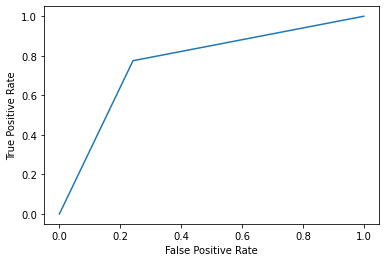

In [117]:
#create ROC curve
fpr, tpr, thresholds = roc_curve(y_test,  y_pred_smote)
plt.plot(fpr,tpr)
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [112]:
# Since our model has imporved for the Target class we can say that it has improved,but we will try with another models.
# Train AND Test are not having equal score which means model is not underfitting. 

### Using Decision tree model

In [118]:
from sklearn.tree import DecisionTreeClassifier
dc=DecisionTreeClassifier(random_state=10)
dc_model=dc.fit(X_train_sm,y_train_sm)

y_pred_dc=dc_model.predict(X_test)

print(classification_report(y_test,y_pred_dc))
print()

print('RFC score ',np.mean(cross_val_score(dc,X_train_sm,y_train_sm,cv=5)))
print()
print(confusion_matrix(y_test,y_pred_dc))
print()
print('train score ',dc_model.score(X_train_sm,y_train_sm))
print()
print('test score ',dc_model.score(X_test,y_test))

              precision    recall  f1-score   support

           0       0.97      0.92      0.94     25636
           1       0.46      0.69      0.55      2645

    accuracy                           0.89     28281
   macro avg       0.71      0.80      0.75     28281
weighted avg       0.92      0.89      0.90     28281


RFC score  0.9159256670991894

[[23480  2156]
 [  818  1827]]

train score  1.0

test score  0.8948410593684806


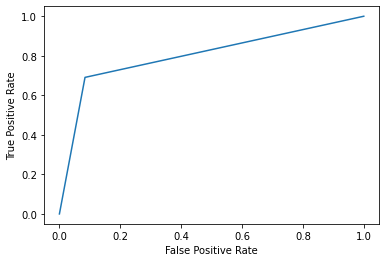

In [119]:
#create ROC curve
fpr, tpr, thresholds = roc_curve(y_test,  y_pred_dc)
plt.plot(fpr,tpr)
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [124]:
#Model is Overfitting

### Tuned Random Forest Model

In [115]:
from sklearn.ensemble import GradientBoostingClassifier,RandomForestClassifier
Rfc=RandomForestClassifier(random_state=10,criterion='gini',max_depth= 5,min_samples_split= 2,n_estimators =200)
Rfc_modeltune=Rfc.fit(X_train_sm,y_train_sm)

y_pred_tune=Rfc_modeltune.predict(X_test)

print(classification_report(y_test,y_pred_tune))
print()
print('RFC score ',np.mean(cross_val_score(Rfc_modeltune,X_train_sm,y_train_sm,cv=5)))
print()
print(confusion_matrix(y_test,y_pred_tune))
print()
print('train score ',Rfc_modeltune.score(X_train_sm,y_train_sm))
print()
print('test score ',Rfc_modeltune.score(X_test,y_test))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97     25636
           1       0.70      0.70      0.70      2645

    accuracy                           0.94     28281
   macro avg       0.83      0.83      0.83     28281
weighted avg       0.94      0.94      0.94     28281


RFC score  0.8812228159209845

[[24838   798]
 [  796  1849]]

train score  0.8812031835205992

test score  0.9436370708249354


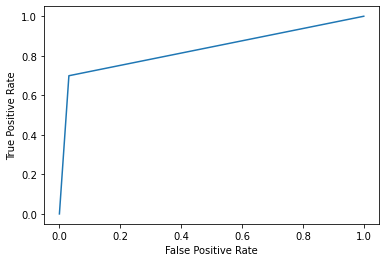

In [116]:
#create ROC curve
fpr, tpr, thresholds = roc_curve(y_test,  y_pred_tune)
plt.plot(fpr,tpr)
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

### Using adaboost model

In [117]:
from sklearn.ensemble import AdaBoostClassifier
abc=AdaBoostClassifier(random_state=10)
abc_model=abc.fit(X_train_sm,y_train_sm)

y_pred_ada=abc_model.predict(X_test)

print(classification_report(y_test,y_pred_ada))
print()

print('RFC score ',np.mean(cross_val_score(abc,X_train_sm,y_train_sm,cv=5)))
print()
print(confusion_matrix(y_test,y_pred_ada))

print('train score ',abc_model.score(X_train_sm,y_train_sm))

print('test score ',abc_model.score(X_test,y_test))

              precision    recall  f1-score   support

           0       0.97      0.93      0.95     25636
           1       0.50      0.71      0.58      2645

    accuracy                           0.91     28281
   macro avg       0.73      0.82      0.77     28281
weighted avg       0.92      0.91      0.91     28281


RFC score  0.9038704119515975

[[23748  1888]
 [  772  1873]]
train score  0.9067230415106118
test score  0.9059439199462537


In [118]:
pip install parfit==0.220

Note: you may need to restart the kernel to use updated packages.


In [119]:
from sklearn.model_selection import ParameterGrid

import parfit.parfit as pf

from sklearn.metrics import roc_auc_score, recall_score
#Check first with Adaboost
ad = AdaBoostClassifier()

paramGrid = ParameterGrid({
    'n_estimators': [100,150,175,200,250],
    'learning_rate': [0.1,0.3,0.5,0.7,0.9]    
})

-------------FITTING MODELS-------------


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   53.2s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done  21 out of  25 | elapsed:  3.1min remaining:   35.9s
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  3.7min finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


-------------SCORING MODELS-------------


[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:   19.5s finished


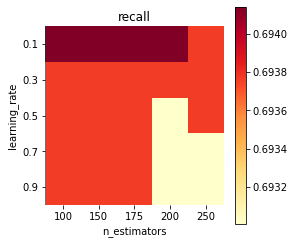

In [120]:
best_model, best_score, all_models, all_scores = pf.bestFit(ad, paramGrid, 
     X_train,y_train,X_test, y_test, 
     metric=recall_score, scoreLabel='recall')

In [121]:
#Tunned Adaboost

In [122]:
from sklearn.ensemble import AdaBoostClassifier
abc=AdaBoostClassifier(random_state=20,n_estimators=100,learning_rate=0.1)
abc_model_tune=abc.fit(X_train_sm,y_train_sm)

y_pred_ada_tune=abc_model.predict(X_test)

print(classification_report(y_test,y_pred_ada_tune))
print()

print('RFC score ',np.mean(cross_val_score(abc,X_train_sm,y_train_sm,cv=5)))
print()
print(confusion_matrix(y_test,y_pred_ada_tune))

print('train score ',abc_model_tune.score(X_train_sm,y_train_sm))

print('test score ',abc_model_tune.score(X_test,y_test))

              precision    recall  f1-score   support

           0       0.97      0.93      0.95     25636
           1       0.50      0.71      0.58      2645

    accuracy                           0.91     28281
   macro avg       0.73      0.82      0.77     28281
weighted avg       0.92      0.91      0.91     28281


RFC score  0.8822224988282183

[[23748  1888]
 [  772  1873]]
train score  0.8805106897627965
test score  0.9545277748311587


### Gradient Boost Model

In [123]:
from sklearn.ensemble import GradientBoostingClassifier
gb = GradientBoostingClassifier(random_state=10)
pred_test_gb_sm = gb.fit(X_train_sm,y_train_sm).predict(X_test)

print(classification_report(y_test,pred_test_gb_sm))
print()

print('RFC score ',np.mean(cross_val_score(gb,X_train_sm,y_train_sm,cv=5)))
print()
print(confusion_matrix(y_test,pred_test_gb_sm))

print('train score ',gb.score(X_train_sm,y_train_sm))

print('test score ',gb.score(X_test,y_test))

              precision    recall  f1-score   support

           0       0.97      0.93      0.95     25636
           1       0.51      0.71      0.59      2645

    accuracy                           0.91     28281
   macro avg       0.74      0.82      0.77     28281
weighted avg       0.93      0.91      0.92     28281


RFC score  0.9064550333441357

[[23825  1811]
 [  771  1874]]
train score  0.9067132880774033
test score  0.9087019553764011


### Using XGboost

In [124]:
pip install xgboost

Note: you may need to restart the kernel to use updated packages.


In [125]:


from xgboost import XGBClassifier
xgb=XGBClassifier(random_state=10,eval_metric='logloss',use_label_encoder=False)
xgb_model=xgb.fit(X_train_sm,y_train_sm)
y_pred_xgb=xgb_model.predict(X_test)

print(classification_report(y_test,y_pred_xgb))
print()

print('RFC score ',np.mean(cross_val_score(xgb,X_train_sm,y_train_sm,cv=5)))
print()
print(confusion_matrix(y_test,y_pred_xgb))

print('train score ',xgb_model.score(X_train_sm,y_train_sm))

print('test score ',xgb_model.score(X_test,y_test))

              precision    recall  f1-score   support

           0       0.97      0.94      0.95     25636
           1       0.55      0.70      0.62      2645

    accuracy                           0.92     28281
   macro avg       0.76      0.82      0.78     28281
weighted avg       0.93      0.92      0.92     28281


RFC score  0.9127899615573923

[[24091  1545]
 [  781  1864]]
train score  0.9221042056803995
test score  0.9177539690958594


### Use of Parfit for model tuning

-------------FITTING MODELS-------------


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:  6.0min
[Parallel(n_jobs=-1)]: Done  21 out of  25 | elapsed:  7.7min remaining:  1.5min
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  8.8min finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


-------------SCORING MODELS-------------


[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    2.6s finished


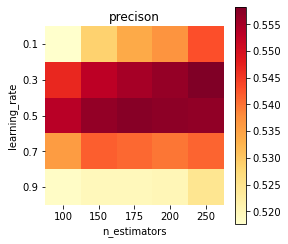

In [126]:
from sklearn.model_selection import ParameterGrid

import parfit.parfit as pf

from sklearn.metrics import roc_auc_score, recall_score
xg = XGBClassifier()

paramGrid = ParameterGrid({
    'n_estimators': [100,150,175,200,250],
    'learning_rate': [0.1,0.3,0.5,0.7,0.9],
    
})
best_model, best_score, all_models, all_scores = pf.bestFit(xg, paramGrid, 
     X_train_sm, y_train_sm, X_test, y_test, 
     metric=precision_score, scoreLabel='precison')

### Tunned XG Boost

In [127]:
from xgboost import XGBClassifier
xgb=XGBClassifier(random_state=10,eval_metric='logloss',use_label_encoder=False,n_estimators=250,learning_rate=0.3)
xgb_model_tune=xgb.fit(X_train_sm,y_train_sm)
y_pred_xgb_tune=xgb_model.predict(X_test)

print(classification_report(y_test,y_pred_xgb_tune))
print()

print('RFC score ',np.mean(cross_val_score(xgb,X_train_sm,y_train_sm,cv=5)))
print()
print(confusion_matrix(y_test,y_pred_xgb_tune))

print('train score ',xgb_model_tune.score(X_train_sm,y_train_sm))

print('test score ',xgb_model_tune.score(X_test,y_test))

              precision    recall  f1-score   support

           0       0.97      0.94      0.95     25636
           1       0.55      0.70      0.62      2645

    accuracy                           0.92     28281
   macro avg       0.76      0.82      0.78     28281
weighted avg       0.93      0.92      0.92     28281


RFC score  0.9190809251450958

[[24091  1545]
 [  781  1864]]
train score  0.9348373127340824
test score  0.9202291290972738


In [ ]:
#CONCLUSIN

We want to pay special attention to accuracy, precision, recall, and the F1 score.  Accuracy is a performance metric that is very intuitive: it is simply the ratio of all correctly predicted cases whether positive or negative and all cases in the data.  

Precision is the ratio of correctly predicted positive cases vs. all predicted positive cases. It answers the following question: Of all people in the database we predicted as defaulters (fraud), how many were actually fraud? If we think about it, high precision should yield to a low false positive rate. This is important in terms of marketing ,the marketing team has to focus the target customers who ar actually purchasing the products!  If we want to maximize our profit, precision is key.

 Recall or sensitivity is the ratio of all correctly identified target class  divided by all actually target cases.  It answers the following question: How well did our model perform in correctly identifying fraud class of customers among all true  customers.  This is important if we want to maximize overall response (call it revenue maximization)

The F1 Score is the weighted average of precision and recall, hence it takes both false positives and false negatives into account. If data has an uneven class distribution, then the F1 score is far more useful than accuracy.  Accuracy works best if false positives and false negatives have similar values. If the value of false positives and false negatives are very different, it’s better to look at both precision and recall. 

ROC AUC:
ROC stands for Receiver Operating Characteristic,  used to evaluate the performance of model .   sensitivity is the proportion of correctly predicted events (cases), while specificity is the the proportion of correctly identified non-events (cases).  Ideally, both specificity and sensitivity should be high.  The ROC curve represents the tradeoff between the two constructs.  

The ROC-AUC score provides us with information about how well a model is performing its job of separating cases: in our case distinguishing fraud class from those who are actually making a purchase . A 0.92 score means that there is a 92% chance that a model can distinguish fraud from non fraud.  


Accuracy: Tuned random forest model best  accuracy with score of 94.00 followed by XG Boost Model and tuned XG Boost produced the accuracy with identical scores at 92.00 


F1 Score: Tuned Random Forest  gave best result

ROC Score: Adaptive Boosting achieved the best score followed by gradient boosting and then XG Boost. 

# FINAL INFERENCE

Tuned Random Forest model is probably a best choice as it provides the best accuracy and F1 Score  It is the best model in separating fraud purchase  from non-fraud purchase. 

###### The company would like to segment their customers using various attributes, so that they can perform targeted marketing campaign. Do the following to group the customers in the different clusters

In the original feature engineered dataset, exclude the following columns: ids, dates, class (target column)
Convert all the input variables to numeric
Using Elbow method identify optimal number of clusters required to group customers in to various clusters
Perform K-Means clustering using appropriate number of clusters
Tag each customer with a cluster
Cluster-wise report average values of all input variables

#### Using Elbow method identify optimal number of clusters required to group customers in to various clusters
Perform K-Means clustering using appropriate number of clusters
Tag each customer with a cluster
Cluster-wise report average values of all input variables

In [128]:
df3 = pd.read_csv('Purchase_Fraud_data.csv')
df3.head(5)

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,22-2-1976
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,2-1-1962
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,5-3-1962
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,3-7-1974
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,25-8-1970


In [129]:
df3

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,22-2-1976
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,2-1-1962
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,5-3-1962
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,3-7-1974
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,25-8-1970
...,...,...,...,...,...,...,...,...,...,...,...,...
151107,345170,2015-01-27 03:03:34,2015-03-29 00:30:47,58549,XPSKTWGPWINLR,SEO,Chrome,M,3.451155e+09,1,apparels,7-8-1987
151108,274471,2015-05-15 17:43:29,2015-05-26 12:24:39,57952,LYSFABUCPCGBA,SEO,Safari,M,2.439047e+09,0,electronics,9-10-1983
151109,368416,2015-03-03 23:07:31,2015-05-20 07:07:47,19003,MEQHCSJUBRBFE,SEO,IE,F,2.748471e+09,0,health_care,17-9-1989
151110,207709,2015-07-09 20:06:07,2015-09-07 09:34:46,68296,CMCXFGRHYSTVJ,SEO,Chrome,M,3.601175e+09,0,electronics,1-2-1978


In [130]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 151112 entries, 0 to 151111
Data columns (total 12 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   user_id         151112 non-null  int64  
 1   signup_time     151112 non-null  object 
 2   purchase_time   151112 non-null  object 
 3   purchase_value  151112 non-null  int64  
 4   device_id       151112 non-null  object 
 5   source          151112 non-null  object 
 6   browser         151112 non-null  object 
 7   sex             146185 non-null  object 
 8   ip_address      151112 non-null  float64
 9   class           151112 non-null  int64  
 10  category        151112 non-null  object 
 11  dob             146188 non-null  object 
dtypes: float64(1), int64(3), object(8)
memory usage: 13.8+ MB


In [131]:
import datetime as dt
df3['dob'] = pd.to_datetime(df3['dob'], format = "%d-%m-%Y")
now = pd.Timestamp('now')
df3['age'] = (now - df3['dob'])
df3['age']  = df3['age'].astype(str)
df3[['age','age_waste']] = df3['age'].str.split("days",expand=True)

In [7]:
df3 = df3.drop(['age_waste'],axis = 1)
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 151112 entries, 0 to 151111
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   user_id         151112 non-null  int64         
 1   signup_time     151112 non-null  object        
 2   purchase_time   151112 non-null  object        
 3   purchase_value  151112 non-null  int64         
 4   device_id       151112 non-null  object        
 5   source          151112 non-null  object        
 6   browser         151112 non-null  object        
 7   sex             146185 non-null  object        
 8   ip_address      151112 non-null  float64       
 9   class           151112 non-null  int64         
 10  category        151112 non-null  object        
 11  dob             146188 non-null  datetime64[ns]
 12  age             151112 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(3), object(8)
memory usage: 15.0+ MB


In [136]:
df3['age'] = pd.to_numeric(df3['age'], errors='coerce')

In [137]:
df3['age']=df3['age']/365

In [138]:
import datetime as dt
df3['tot_mins_diff']=pd.to_datetime(df3['purchase_time'])-pd.to_datetime(df3['signup_time'])

df3.head()

df3['tot_mins_diff'] = df3['tot_mins_diff'].dt.total_seconds()

# Conversion of Difference in Minutes 

df3['tot_mins_diff']=df3['tot_mins_diff']/60

df3.head()

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,ip_address,class,category,dob,age,age_waste,tot_mins_diff
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,65278,QVPSPJUOCKZAR,SEO,Chrome,M,7.327584e+08,0,home_essentials,1976-02-22,47.183562,13:07:18.523649,75111.366667
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,96399,EOGFQPIZPYXFZ,Ads,Chrome,F,3.503114e+08,0,apparels,1962-01-02,61.331507,13:07:18.523649,299.066667
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,57296,YSSKYOSJHPPLJ,SEO,Opera,M,2.621474e+09,1,electronics,1962-03-05,61.161644,13:07:18.523649,0.016667
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,43650,ATGTXKYKUDUQN,SEO,Safari,M,3.840542e+09,0,health_care,1974-07-03,48.824658,13:07:18.523649,8201.416667
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,45016,NAUITBZFJKHWW,Ads,Safari,M,4.155831e+08,0,home_essentials,1970-08-25,52.682192,13:07:18.523649,72691.016667


<AxesSubplot:xlabel='category', ylabel='age'>

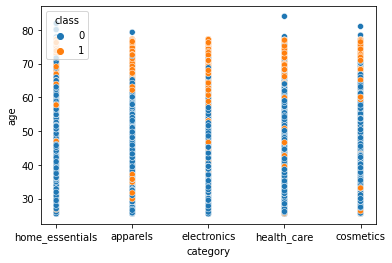

In [139]:
sns.scatterplot(data=df3, x="category", y="age",hue='class')

<AxesSubplot:xlabel='category', ylabel='age'>

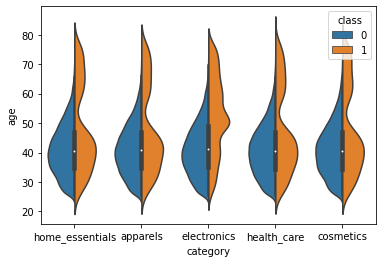

In [140]:
sns.violinplot(data=df3, x="category", y="age", hue="class", split=True)

<AxesSubplot:xlabel='age', ylabel='category'>

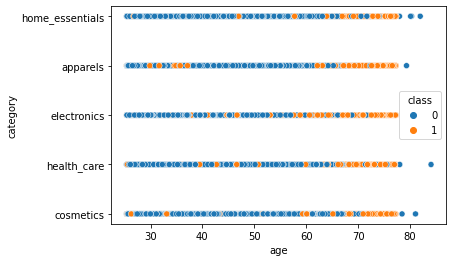

In [141]:
sns.scatterplot(data=df3, x="age", y="category",hue='class')

<AxesSubplot:xlabel='category', ylabel='age'>

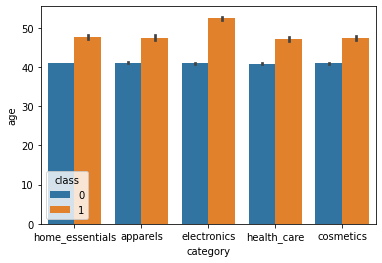

In [142]:
sns.barplot(data=df3, x="category", y="age", hue="class")

#We take three features for consideration of creating customer segemntation which are : 'purchase_value','age','tot_mins_diff'


In [143]:
features=pd.DataFrame(df3, columns = ['purchase_value','age','tot_mins_diff'])


In [144]:
features=pd.get_dummies(features,drop_first=True)

In [145]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [146]:
features.head(5)

,purchase_value,age,tot_mins_diff
0,65278,47.183562,75111.366667
1,96399,61.331507,299.066667
2,57296,61.161644,0.016667
3,43650,48.824658,8201.416667
4,45016,52.682192,72691.016667


In [147]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [148]:
features = features.dropna()

In [149]:
features.head(5)

,purchase_value,age,tot_mins_diff
0,65278,47.183562,75111.366667
1,96399,61.331507,299.066667
2,57296,61.161644,0.016667
3,43650,48.824658,8201.416667
4,45016,52.682192,72691.016667


In [150]:
#create scaled DataFrame where each variable has mean of 0 and standard dev of 1
scaled_df = StandardScaler().fit_transform(features)

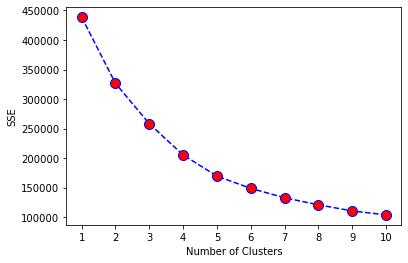

In [151]:
#initialize kmeans parameters
kmeans_kwargs = {
"init": "random",
"n_init": 10,
"random_state": 1,
}

#create list to hold SSE values for each k
sse = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_df)
    sse.append(kmeans.inertia_)

#visualize results
plt.plot(range(1, 11), sse,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.xticks(range(1, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

#Perform K-Means Clustering with Optimal K=4

In [153]:
#instantiate the k-means class, using optimal number of clusters
kmeans = KMeans(init="random", n_clusters=4, n_init=10, random_state=1)

#fit k-means algorithm to data
kmeans.fit(scaled_df)

#view cluster assignments for each observation
kmeans.labels_

array([2, 3, 3, ..., 0, 2, 0])

In [154]:
#append cluster assingments to original DataFrame
features['cluster'] = kmeans.labels_

#view updated DataFrame
print(features)

        purchase_value        age  tot_mins_diff  cluster
0                65278  47.183562   75111.366667        2
1                96399  61.331507     299.066667        3
2                57296  61.161644       0.016667        3
3                43650  48.824658    8201.416667        3
4                45016  52.682192   72691.016667        3
...                ...        ...            ...      ...
151107           58549  35.720548   87687.216667        2
151108           57952  39.550685   15521.166667        1
151109           19003  33.605479  111360.266667        0
151110           68296  45.238356   85768.650000        2
151111           23622  45.857534   58741.550000        0

[146188 rows x 4 columns]


# Getting the total count of the customers belonging to various  clusters

In [155]:
cust1=features[features["cluster"]==0]
print('Number of customer in 1st group=', len(cust1))

Number of customer in 1st group= 40388


In [156]:
cust2=features[features["cluster"]==1]
print('Number of customer in 2nd group=', len(cust2))

Number of customer in 2nd group= 41896


In [157]:
cust3=features[features["cluster"]==2]
print('Number of customer in 1st group=', len(cust3))

Number of customer in 1st group= 39126


In [158]:
cust4=features[features["cluster"]==3]
print('Number of customer in 1st group=', len(cust4))

Number of customer in 1st group= 24778


In [165]:
x = features.values

C:\Users\asus\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\asus\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\asus\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\asus\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\asus\anaconda3\lib\site-packages\sklearn\cluster\_k

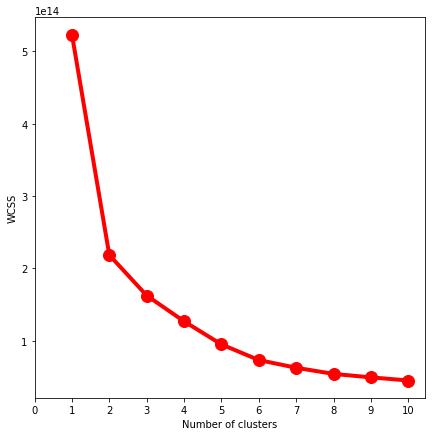

In [166]:
WCSS = []
for i in range(1,11):
    model = KMeans(n_clusters = i,init = 'k-means++')
    model.fit(x)
    WCSS.append(model.inertia_)
fig = plt.figure(figsize = (7,7))
plt.plot(range(1,11),WCSS, linewidth=4, markersize=12,marker='o',color = 'red')
plt.xticks(np.arange(11))
plt.xlabel("Number of clusters")
plt.ylabel("WCSS")
plt.show()

In [167]:
model = KMeans(n_clusters = 4, init = "k-means++", max_iter = 300, n_init = 10, random_state = 0)
y_clusters = model.fit_predict(x)

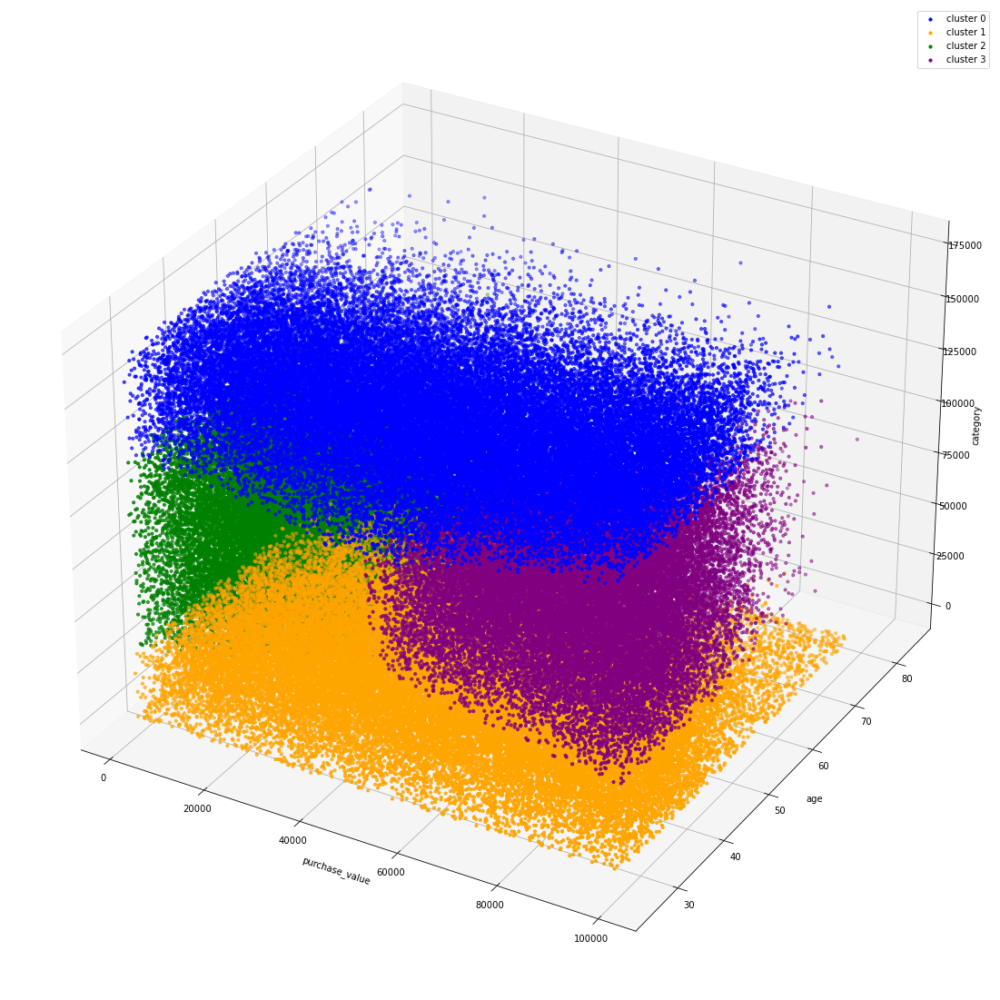

In [168]:
fig = plt.figure(figsize = (20,20))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x[y_clusters == 0,0],x[y_clusters == 0,1],x[y_clusters == 0,2], s = 10 , color = 'blue', label = "cluster 0")
ax.scatter(x[y_clusters == 1,0],x[y_clusters == 1,1],x[y_clusters == 1,2], s = 10 , color = 'orange', label = "cluster 1")
ax.scatter(x[y_clusters == 2,0],x[y_clusters == 2,1],x[y_clusters == 2,2], s = 10 , color = 'green', label = "cluster 2")
ax.scatter(x[y_clusters == 3,0],x[y_clusters == 3,1],x[y_clusters == 3,2], s = 10 , color = 'purple', label = "cluster 3")
ax.set_xlabel('purchase_value')
ax.set_ylabel('age')
ax.set_zlabel('category')
ax.legend()
plt.show()

# Customer clusters based on age group , purchase value and tot_mins_diff( difference between sign up time and purchase time)

Customer clusters based on age group , purchase value and tot_mins_diff( differnece between sign up time and purchase time
from the above graph we can infer :


cluster 0 indicated with blue has customer base in age group of 40- 80 years where there tot_mins_diff is in range 50000 to 10000 mins and purchase value has high range 0-80000
The total count of customers in cluster 0 is 40388

cluster 1 indicated with orange color has customer base in age group of 
30- 80 years where there tot_mins_diff is in range 0 to 25000 mins and purchase value has  range 0 to 85000
The total count of customers in cluster 1 is 41896

cluster 2 indicated with green color  has customer base in age group of 
30- 60 years where there tot_mins_diff is in range 0 to 25000 mins and purchase value has  range 0-90000
The total count of customers in cluster 2 is 39126

cluster 3 indicated with purple color  has customer base in age group of 
40- 90 years where there tot_mins_diff is in range 0 to approximately 80000 mins and purchase value has high range 25000-90000
The total count of customers in cluster 3 is 24778

In [169]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [170]:
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objs as go
from plotly import tools
from plotly.subplots import make_subplots
import plotly.offline as py

In [172]:
Scene = dict(xaxis = dict(title  = 'purchase_value'),yaxis = dict(title  = 'age'),zaxis = dict(title  = 'tot_mins_diff'))

# model.labels_ is nothing but the predicted clusters i.e y_clusters
labels = model.labels_
trace = go.Scatter3d(x=x[:, 0], y=x[:, 1], z=x[:, 2], mode='markers',marker=dict(color = labels, size= 10, line=dict(color= 'black',width = 10)))
layout = go.Layout(margin=dict(l=0,r=0),scene = Scene,height = 800,width = 800)
data = [trace]
fig = go.Figure(data = data, layout = layout)
fig.show()